# Gecco Challenge - Inspection and EDA


# Import Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


## Loading the data


In [2]:
data_raw_path = "../data/raw/waterDataTraining.csv"

# Load the dataset
df = pd.read_csv(data_raw_path)

## Data Inspection

### Basic DIs

In [3]:
df.head()

,Time,Tp,Cl,pH,Redox,Leit,Trueb,Cl_2,Fm,Fm_2,EVENT
0,2016-08-03T09:49:00Z,6.5,0.17,8.36,749.0,211.0,0.011,0.118,1677.0,695.0,False
1,2016-08-03T09:50:00Z,6.5,0.17,8.36,749.0,211.0,0.011,0.118,1561.0,696.0,False
2,2016-08-03T09:51:00Z,6.5,0.17,8.35,749.0,211.0,0.011,0.117,1581.0,696.0,False
3,2016-08-03T09:52:00Z,6.5,0.17,8.35,749.0,211.0,0.011,0.118,1579.0,693.0,False
4,2016-08-03T09:53:00Z,6.5,0.17,8.35,749.0,211.0,0.011,0.118,1567.0,689.0,False


In [4]:
df.tail()

,Time,Tp,Cl,pH,Redox,Leit,Trueb,Cl_2,Fm,Fm_2,EVENT
139561,2016-11-08T07:50:00Z,10.1,0.16,8.41,762.0,189.0,0.023,0.105,1799.0,924.0,False
139562,2016-11-08T07:51:00Z,10.1,0.17,8.41,762.0,190.0,0.022,0.106,1835.0,927.0,False
139563,2016-11-08T07:52:00Z,10.1,0.17,8.41,762.0,190.0,0.022,0.106,1807.0,924.0,False
139564,2016-11-08T07:53:00Z,10.1,0.17,8.41,762.0,190.0,0.022,0.106,1799.0,930.0,False
139565,2016-11-08T07:54:00Z,10.1,0.17,8.41,762.0,189.0,0.022,0.106,1817.0,925.0,False


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 139566 entries, 0 to 139565
Data columns (total 11 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    139566 non-null  object 
 1   Tp      138522 non-null  float64
 2   Cl      138521 non-null  float64
 3   pH      138522 non-null  float64
 4   Redox   138522 non-null  float64
 5   Leit    138522 non-null  float64
 6   Trueb   138522 non-null  float64
 7   Cl_2    138522 non-null  float64
 8   Fm      138522 non-null  float64
 9   Fm_2    138522 non-null  float64
 10  EVENT   139566 non-null  bool   
dtypes: bool(1), float64(9), object(1)
memory usage: 10.8+ MB


In [6]:
df.shape

(139566, 11)

In [7]:
df.columns

Index(['Time', 'Tp', 'Cl', 'pH', 'Redox', 'Leit', 'Trueb', 'Cl_2', 'Fm',
       'Fm_2', 'EVENT'],
      dtype='object')

In [8]:
df.dtypes

Time      object
Tp       float64
Cl       float64
pH       float64
Redox    float64
Leit     float64
Trueb    float64
Cl_2     float64
Fm       float64
Fm_2     float64
EVENT       bool
dtype: object

#### Summary statistics for numeric columns

In [9]:
df.describe()

,Tp,Cl,pH,Redox,Leit,Trueb,Cl_2,Fm,Fm_2
count,138522.000000,138521.000000,138522.000000,138522.000000,138522.000000,138522.000000,138522.000000,138522.000000,138522.000000
mean,8.521406,0.165482,8.366416,752.899009,209.520998,0.019778,0.106099,1534.208891,927.728014
std,1.281314,0.010207,0.101624,12.945284,7.747497,0.005492,0.007132,208.171011,147.447430
min,0.000000,0.000000,4.000000,300.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.500000,0.160000,8.340000,751.000000,209.000000,0.016000,0.103000,1388.000000,847.000000
50%,8.400000,0.170000,8.370000,754.000000,211.000000,0.018000,0.106000,1512.000000,925.000000
75%,9.500000,0.170000,8.390000,756.000000,211.000000,0.023000,0.110000,1650.000000,1000.000000
max,11.800000,0.800000,8.936228,895.000000,646.000000,0.254000,0.462000,3923.000000,2592.000000


##### Interpretation from statistics

- Count
   1. All columns have 138522 entries, except `Cl` which has 138521, indicating a missing values.
- Mean
   1. The average temperature (`Tp`) is approximately 8.52°C, that means a generally mild climate in the dataset's context
- Standard Deviation (std)
   1. `Redox` has a std of 12.945, relatively low, indicating that most redox potential measurements are close to the mean (752.899)
- Min
   2. The minimum pH level recorded is 4.00, which is quite acidic and could indicate extreme conditions or measurement errors, considering the rest of the data.
- 25%
   1. We can see that 25% of temperature readings are below 7.5°C.
- 50%
   1. The median pH is 8.37, very close to the mean (8.36), suggesting a symmetric distribution around the central value.
- 75%
   1. 75% of `Leit` measurements are below 211 µS/cm, indicating most water conductivity measurements are tightly grouped.
- MAx
   1. The max value of `Cl` is 0.800 mg/L, which is significantly higher than the 75% (0.170), suggesting outliers or exceptional cases

#### Checking for Missing Values

In [10]:
df.isnull().sum()

Time        0
Tp       1044
Cl       1045
pH       1044
Redox    1044
Leit     1044
Trueb    1044
Cl_2     1044
Fm       1044
Fm_2     1044
EVENT       0
dtype: int64

### Plotting Basic Graphs

Since the goal is about monitoring water quality, parameters like `pH`, turbidity (`Trueb`), and chlorine dioxide levels (`Cl`, `Cl_2`) might be especially relevant.

#### 1. Time Series Plots

Since the dataset includes a time component, it's essential to visualize how different metrics evolve over time. This can highlight trends cycles, and anomalies.

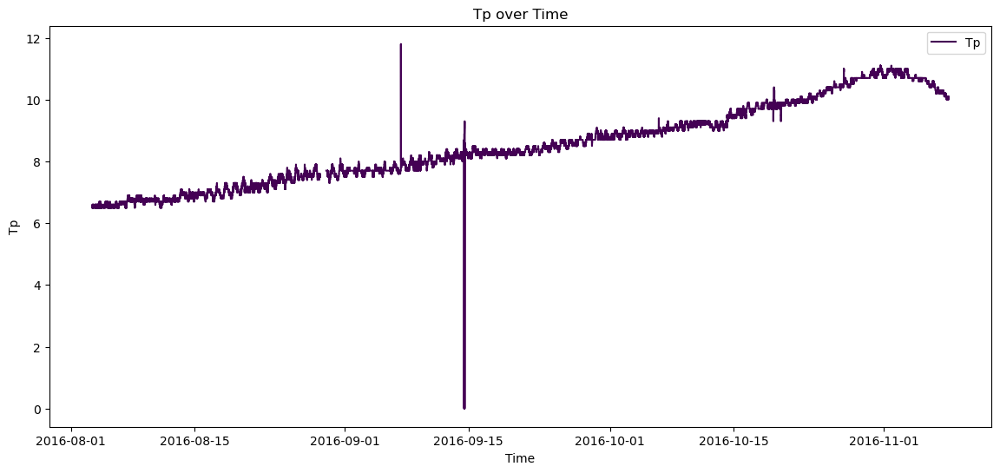

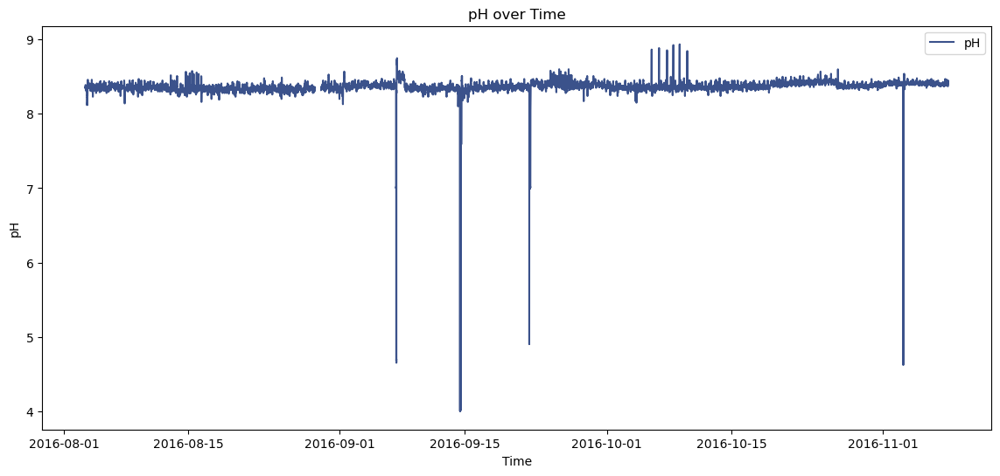

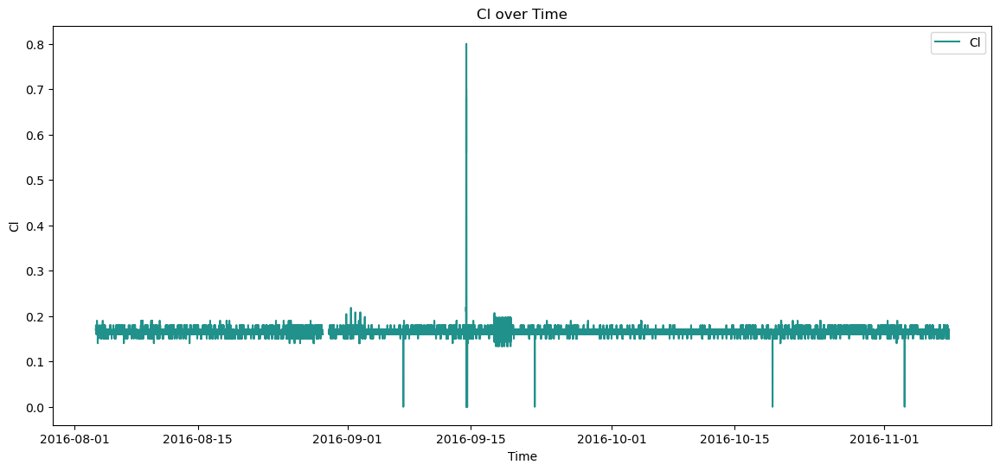

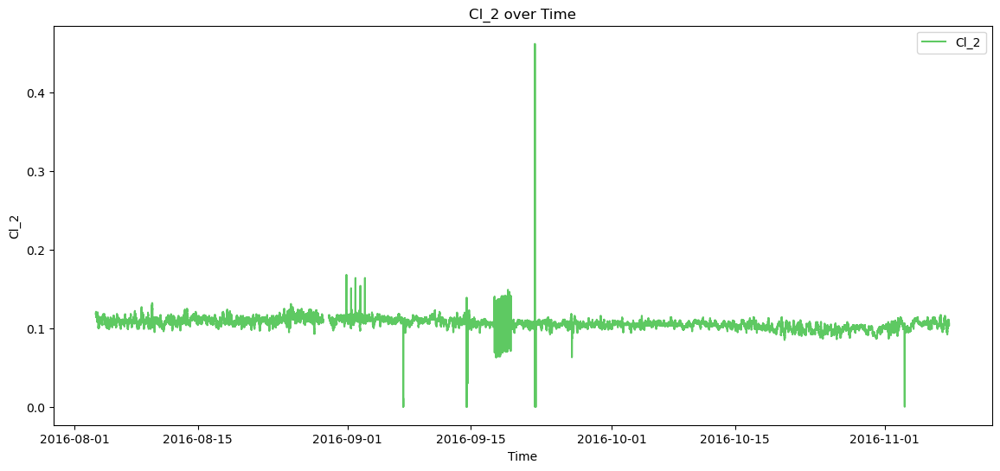

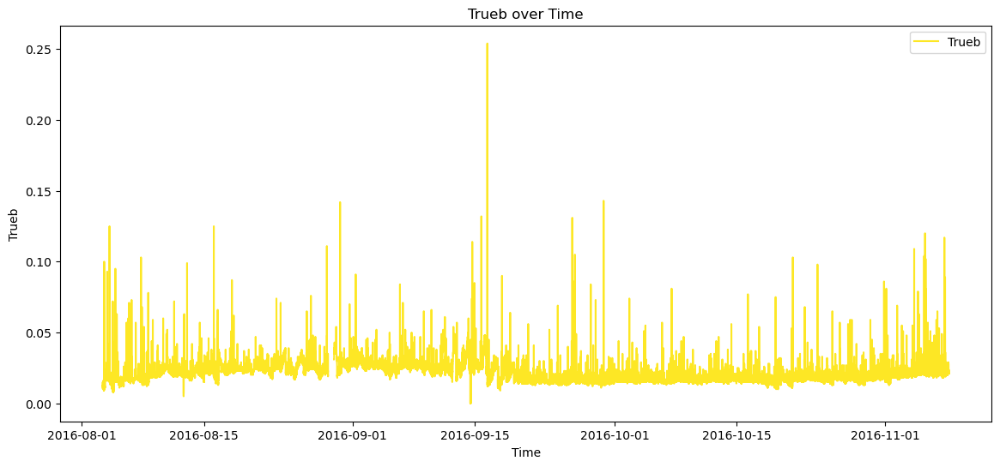

In [11]:
def plot_time_series(df, columns, time_column='Time'):
    """
    This function creates a time series plot for each specified column in the dataframe.

    Parameters:
    df (pd.DataFrame): The dataframe containing the data.
    columns (list of str): List of column names to create time series plots for.
    time_column (str): The column name which contains the time data.

    Returns:
    None
    """
    # Convert 'Time' to datetime format for better plotting, if not already done
    if not pd.api.types.is_datetime64_any_dtype(df[time_column]):
        df[time_column] = pd.to_datetime(df[time_column])
    
    # Define a color cycle to automatically assign colors to each plot
    colors = plt.cm.viridis(np.linspace(0, 1, len(columns)))

    # Create a plot for each specified column
    for column, color in zip(columns, colors):
        plt.figure(figsize=(14, 6))
        plt.plot(df[time_column], df[column], label=f'{column}', color=color)
        plt.title(f'{column} over Time')
        plt.xlabel('Time')
        plt.ylabel(column)
        plt.legend()
        plt.show()

# List of columns we want to plot
time_series_columns = ['Tp', 'pH', 'Cl', 'Cl_2', 'Trueb']
plot_time_series(df, time_series_columns)

#### 2. Scatter Plots to Examine Relationships

##### Relationship between Temperature vs. pH

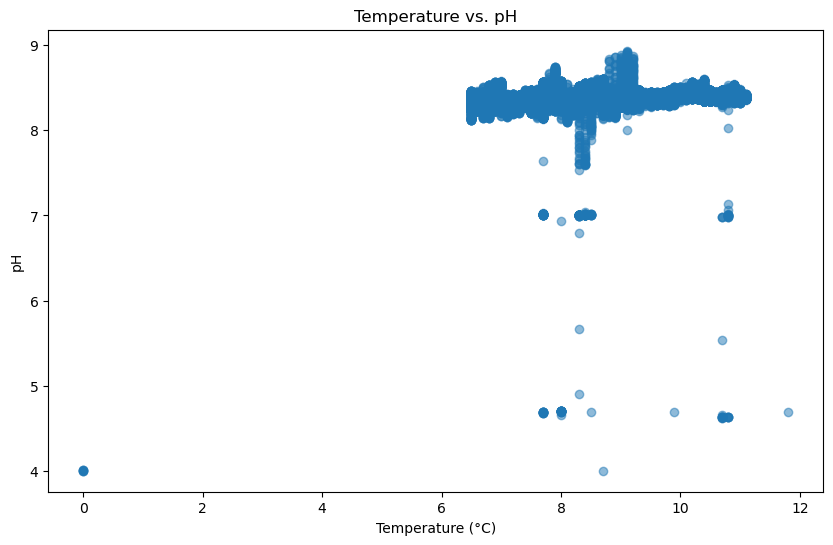

In [12]:
# Relationship between Temperature vs. pH
plt.figure(figsize=(10, 6))
plt.scatter(df['Tp'], df['pH'], alpha=0.5)
plt.title('Temperature vs. pH')
plt.xlabel('Temperature (°C)')
plt.ylabel('pH')
plt.show()


##### pH vs. Chlorine Dioxide Levels (Cl and Cl_2)

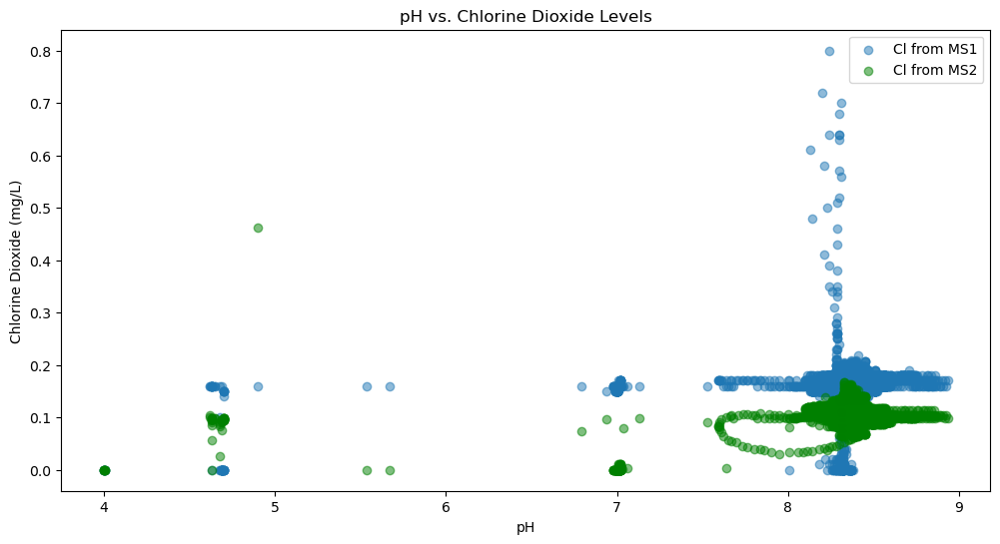

In [13]:
# pH vs. Chlorine Dioxide Levels (Cl and Cl_2)
plt.figure(figsize=(12, 6))
plt.scatter(df['pH'], df['Cl'], alpha=0.5, label='Cl from MS1')
plt.scatter(df['pH'], df['Cl_2'], alpha=0.5, label='Cl from MS2', color='green')
plt.title('pH vs. Chlorine Dioxide Levels')
plt.xlabel('pH')
plt.ylabel('Chlorine Dioxide (mg/L)')
plt.legend()
plt.show()


##### Redox Potential vs. pH

Understanding the relationship between redox potential and pH can be crucial for assessing the oxidative-reductive balance of the water, which impacts treatment processes and water quality.

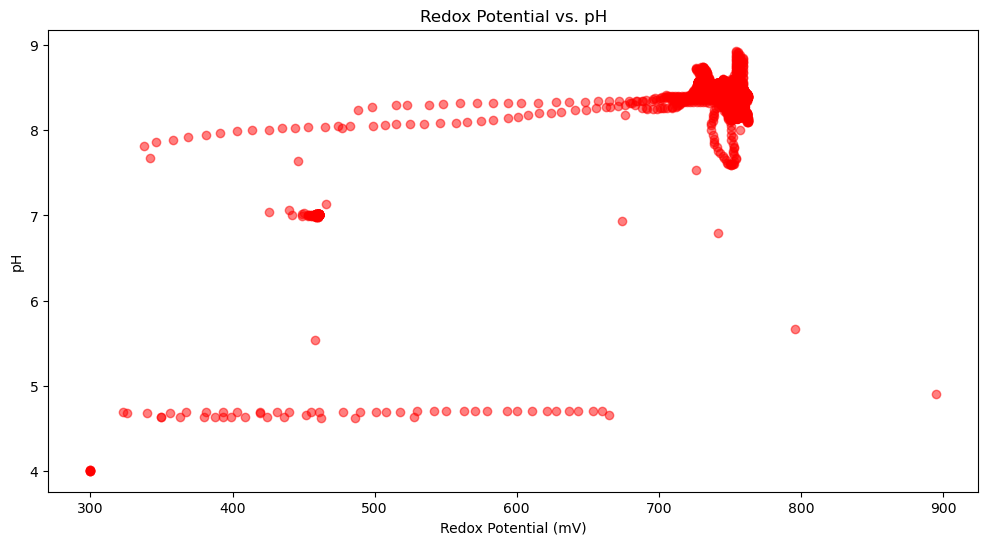

In [14]:
# Redox Potential vs. pH

plt.figure(figsize=(12, 6))
plt.scatter(df['Redox'], df['pH'], alpha=0.5, color='red')
plt.title('Redox Potential vs. pH')
plt.xlabel('Redox Potential (mV)')
plt.ylabel('pH')
plt.show()


#### 3. Boxplots for Distribution and Outliers


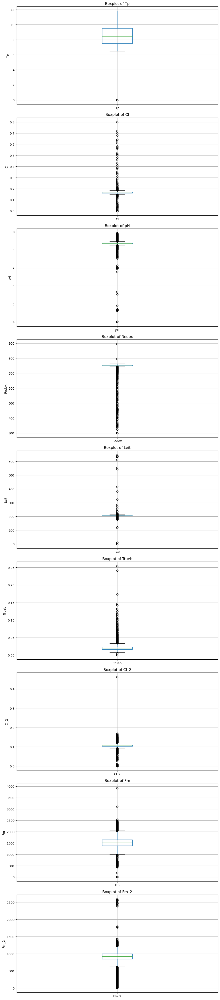

In [15]:
def plot_boxplots(df, columns):
    """
    This function creates a boxplot for each specified column in the dataframe.

    Parameters:
    df (pd.DataFrame): The dataframe containing the data.
    columns (list of str): List of column names to create boxplots for.

    Returns:
    None
    """
    num_plots = len(columns)
    fig, axes = plt.subplots(nrows=num_plots, figsize=(10, num_plots * 5))
    
    if num_plots == 1:
        axes = [axes]  # Make it iterable even if there's only one plot
    
    for ax, column in zip(axes, columns):
        df.boxplot(column=[column], ax=ax)
        ax.set_title(f'Boxplot of {column}')
        ax.set_ylabel(column)

    plt.tight_layout()
    plt.show()

# List of numeric columns you want to plot (adjust as necessary)
numeric_columns = ['Tp', 'Cl', 'pH', 'Redox', 'Leit', 'Trueb', 'Cl_2', 'Fm', 'Fm_2']
plot_boxplots(df, numeric_columns)

#### 4. Histograms for Variable Distributions


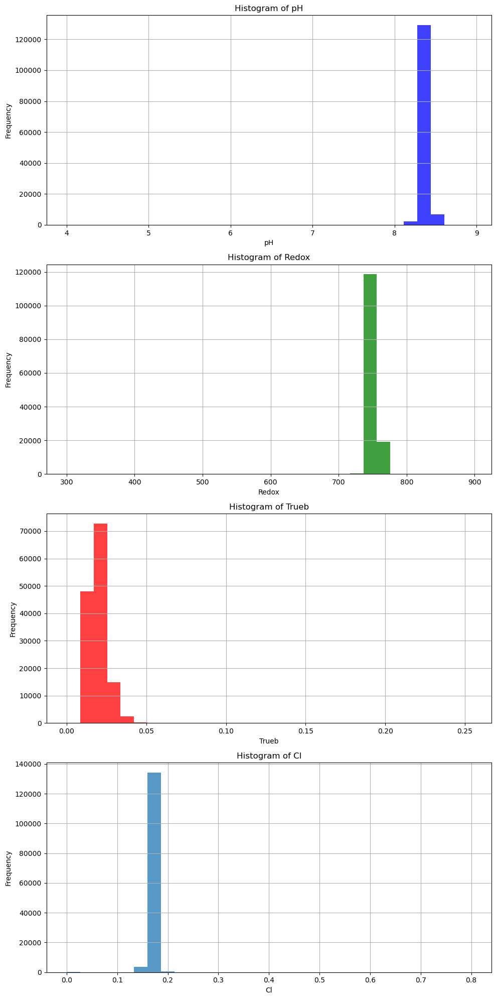

In [16]:
def plot_histograms(df, columns, bins=30, color=None):
    """
    This function creates a histogram for each specified column in the dataframe.

    Parameters:
    df (pd.DataFrame): The dataframe containing the data.
    columns (list of str): List of column names to create histograms for.
    bins (int): Number of bins for the histogram.
    color (str or list): Color for the histograms or a list of colors, one for each histogram.

    Returns:
    None
    """
    num_plots = len(columns)
    fig, axes = plt.subplots(nrows=num_plots, figsize=(10, num_plots * 5))

    if num_plots == 1:
        axes = [axes]  # Make it iterable even if there's only one plot

    # Setting colors for each histogram if multiple are provided
    if not isinstance(color, list):
        color = [color] * num_plots  # Extend the single color to all plots
    else:
        color = color + [None] * (num_plots - len(color))  # Ensure enough colors are provided

    for ax, column, col in zip(axes, columns, color):
        df[column].hist(bins=bins, ax=ax, color=col, alpha=0.75)
        ax.set_title(f'Histogram of {column}')
        ax.set_xlabel(column)
        ax.set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# List of columns to plot histograms for
measure_columns = ['pH', 'Redox', 'Trueb', 'Cl']
plot_histograms(df, measure_columns, bins=30, color=['blue', 'green', 'red'])

#### 5. Plotting Anomalies in Data


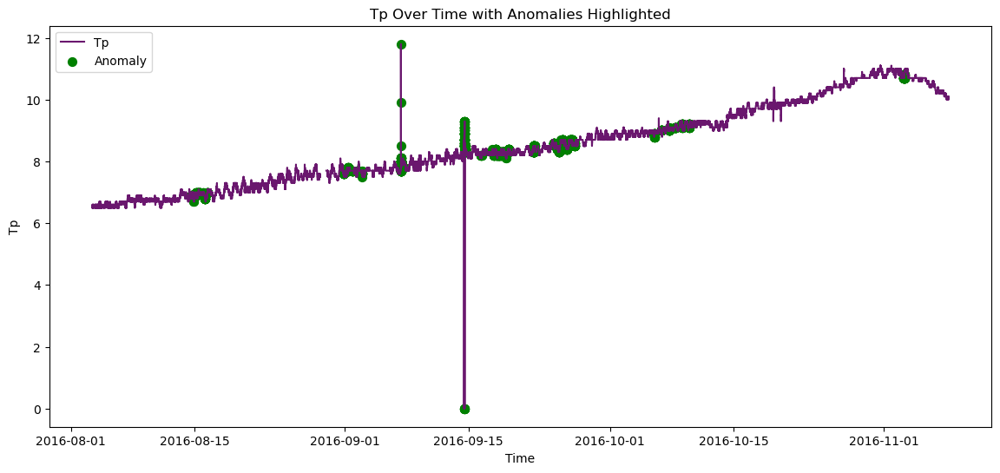

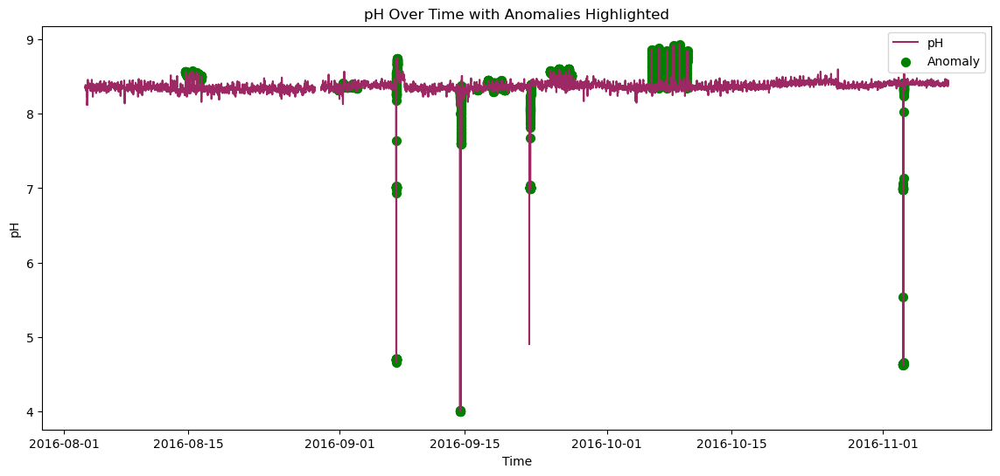

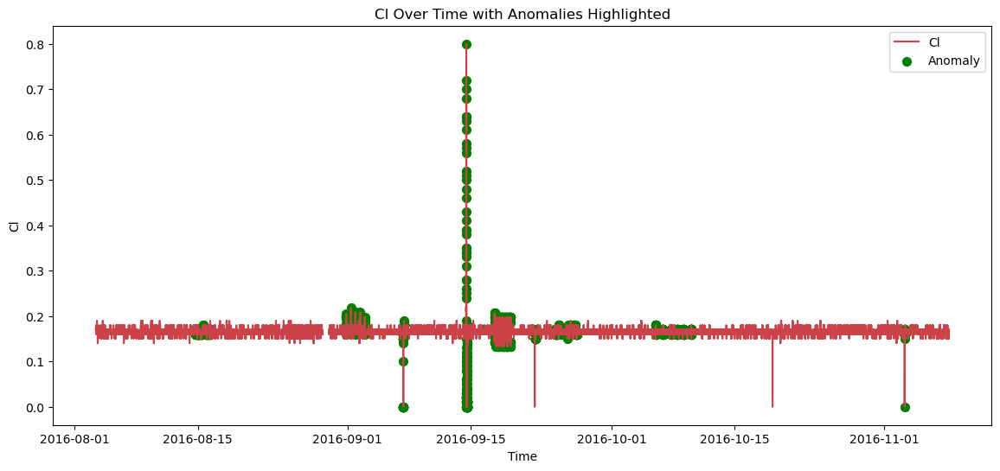

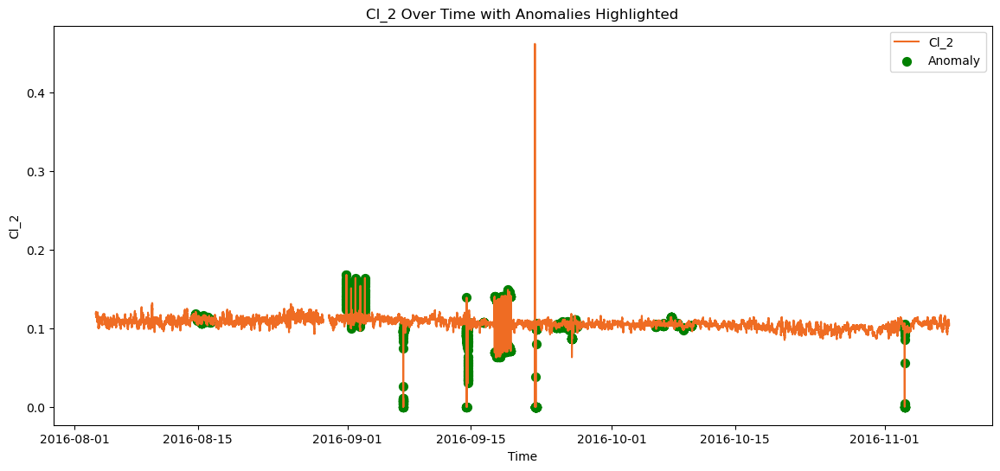

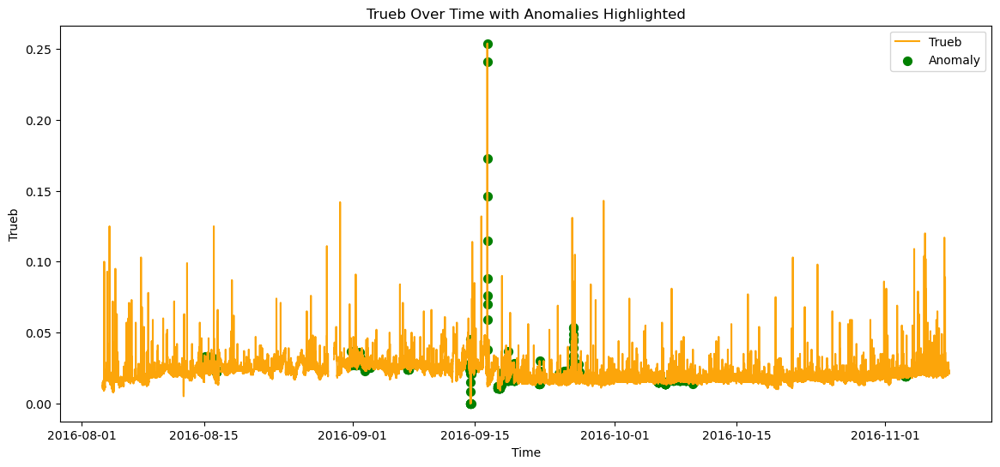

In [17]:
def plot_time_series_with_anomalies(df, columns, time_column='Time', event_column='EVENT'):
    """
    This function creates time series plots for specified columns and highlights anomalies.
    
    Parameters:
    df (pd.DataFrame): The dataframe containing the data.
    columns (list of str): List of column names to create time series plots for.
    time_column (str): The column name which contains the time data.
    event_column (str): The column name which marks anomalies as True/False.
    
    Returns:
    None
    """
    # Ensure 'Time' is in datetime format for better plotting
    if not pd.api.types.is_datetime64_any_dtype(df[time_column]):
        df[time_column] = pd.to_datetime(df[time_column])

    # Define a color palette for the time series
    color_palette = plt.cm.inferno(np.linspace(0.3, 0.8, len(columns)))

    # Plotting each column with anomalies highlighted
    for column, color in zip(columns, color_palette):
        plt.figure(figsize=(14, 6))
        plt.plot(df[time_column], df[column], label=f'{column}', color=color)
        plt.scatter(df[df[event_column]][time_column], df[df[event_column]][column], color='green', label='Anomaly', s=50)  # Anomalies in green
        plt.title(f'{column} Over Time with Anomalies Highlighted')
        plt.xlabel('Time')
        plt.ylabel(column)
        plt.legend()
        plt.show()

# List of columns you want to plot with anomalies
columns_to_plot = ['Tp', 'pH', 'Cl', 'Cl_2', 'Trueb']
plot_time_series_with_anomalies(df, columns_to_plot)

###### (Optional) Interactive plot with Plotly

In [18]:
import plotly.graph_objects as go
import pandas as pd

def plot_time_series_with_anomalies_interactive(df, columns, time_column='Time', event_column='EVENT'):
    """
    This function creates interactive time series plots for specified columns and highlights anomalies.

    Parameters:
    df (pd.DataFrame): The dataframe containing the data.
    columns (list of str): List of column names to create time series plots for.
    time_column (str): The column name which contains the time data.
    event_column (str): The column name which marks anomalies as True/False.

    Returns:
    None
    """
    # Ensure 'Time' is in datetime format for better plotting
    if not pd.api.types.is_datetime64_any_dtype(df[time_column]):
        df[time_column] = pd.to_datetime(df[time_column])

    # Plotting each column with anomalies highlighted
    for column in columns:
        fig = go.Figure()

        # Main time series plot
        fig.add_trace(go.Scatter(x=df[time_column], y=df[column], mode='lines', name=column))

        # Anomalies as scatter points
        anomaly_data = df[df[event_column]]
        fig.add_trace(go.Scatter(x=anomaly_data[time_column], y=anomaly_data[column],
                                 mode='markers', name='Anomaly', marker=dict(color='green', size=10)))

        # Layout settings
        fig.update_layout(title=f'{column} Over Time with Anomalies Highlighted',
                          xaxis_title='Time',
                          yaxis_title=column,
                          legend_title='Legend',
                          xaxis_rangeslider_visible=True)
        fig.show()

# List of columns you want to plot with anomalies
columns_to_plot = ['Tp', 'pH', 'Cl', 'Cl_2', 'Trueb']
plot_time_series_with_anomalies_interactive(df, columns_to_plot)


#### 6. Correlation Matrix


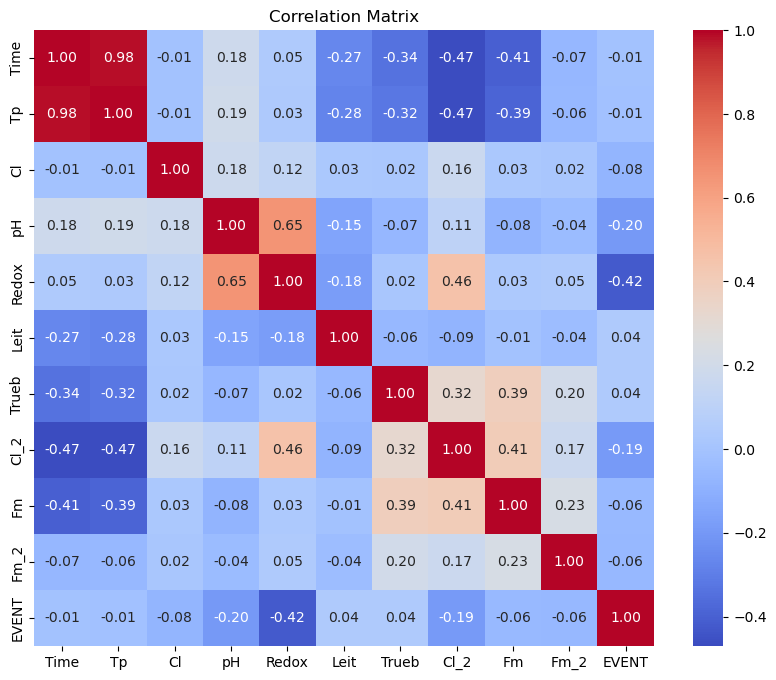

In [20]:
import seaborn as sns

# Compute the correlation matrix
corr = df.corr()

# Generate a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


##### Interpret of Correlation Matrix


- Time and Temperature (`Tp`)
  - Correlation: 0.98
  - This is a very high positive correlation, indicating that as time progresses, temperature also increases signigicantly. This could suggest a trend over time or that the measurements were taken over a period with rising temperatures.
- `pH` and `Redox`
  - Corr: 0.65
  - This indicates that as pH increases, the redox potential also tends to increase.
- `Cl_2` and Redox
  - Corr: 0.45
  - A moderate positive correlation suggests that increases in chlorine dioxide measurements from MS2 are associated with increases in redox potential.
- `Trueb` and `Fm`
  - Corr: 0.39
  - This moderate positive correlation implies that higher turbidity are associated with higher flow rates at water line 1.

Negative Correlations:
- `Leit` and `Tp`
  - Corr: -0.28
  - A negative correlation suggests that the temperature increases, the electrical conductivity decreases.

Correlations Involving `EVENT`
- `Redox` and `EVENT`
  - Corr: -0.41
  - A moderate negative correlation suggests that lower redox potentials are associated with the occurrences labeled as events (anomalies). This might indicate that certain types of anomalies are linked to reduced oxidation-reduction activity.
- `pH` and `EVENT`
  - Corr: -0.19
  - A weaker negative correlation, indicating that lower pH values tend to coincide with anomalies. This could suggest that more acidic conditions might be related to undesirable or anomalous water quality events.

## Part 2. Anomaly Detection with Forecasting using Vector Autoregression (VAR)

### Why VAR?

#### Multivariabte Nature of Data:

- The dataset includes multiple interrelated time-series variables, like temperature, pH, chlorine dioxide levels, redox potential,electrical conductivity, turbidity, and flow rates.
- VAR is specifically designed for multivariate time series data where the predictor variables may influence each other. It models each variable as linear function of past lags of itself past lags of all other variables, making it ideal for capturing the dynamics in this dataset.

#### Interdependencies among variables:
- Water quality parameters are often interdependent. For example, changes in temperature could affect pH levels and biological activities, influencing overall water quality.
- VAR can help in understanding and forecasting the water quality by capturing how each variable contribures to changes in others, which is crucial for effective water management.

### Anomaly Detection with Forecasting:
- VAR can be used to forecast future values of the multivariate time series. By comparing the forecasted values with the actual observed values, significant deviations can be identified as anomalies.
- This method is beneficial where aomalies are expected to manifest as unusual changes in hte relationships between variables (e.g., an unexpected drop in redox potential when other conditions are stable).
  
### The differences between VAR and other autoregressive models like AR, ARMA or ARIMA:

The primary difference is those later models are uni-directional, where, the predictors influence the Y and not vice-versa. Whereas, VAR is bi-directional, meaning each variable in VAR may be influenced by its own lags and the lags of other variables in the system. In other words, the variables influence each other. So, that means VAR models can capture the interdependencies between multiple time series variables.

### Implementation Considerations:

Stationarity: VAR requires the time series to be stationary. This might necessitate differencing, logging, or detrending the data before model fitting.

Model Order Selection: Choosing the number of lags (the order of the model) is critical. Information criteria sucj as AIC (Akaike Information Criterion) or BIC (Bayesian INformation Criterion) can be used to select an appropriate order.

Model Diagnostics: after fitting the model, it's essential to perform checks for autocorrelation of residuals, and other potential issues to ensure the model is well-specified.

### Data Preprocessing for VAR

#### 1. Handling Missing Values

In [21]:
print(df.isnull().sum())
df = df.dropna()


Time        0
Tp       1044
Cl       1045
pH       1044
Redox    1044
Leit     1044
Trueb    1044
Cl_2     1044
Fm       1044
Fm_2     1044
EVENT       0
dtype: int64


#### 2. Testing for Stationarity

Before fitting a VAR model, it's essential to check if the time series are stationary. Stationarity is a key assumption of VAR models. We can use the Augmented Dickey-Fuller (ADF) test to check for stationarity.


In [22]:
from statsmodels.tsa.stattools import adfuller

def test_stationarity(timeseries):
    result = adfuller(timeseries)
    print('\tADF Statistic: %f' % result[0])
    print('\tp-value: %f' % result[1])
    print('\tCritical Values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))

for column in df.columns[1:]:  # Assuming first column is Time, so excluding it
    print(f"Testing stationarity for {column}")
    test_stationarity(df[column])


Testing stationarity for Tp
	ADF Statistic: -1.373389
	p-value: 0.594965
	Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
Testing stationarity for Cl
	ADF Statistic: -34.218837
	p-value: 0.000000
	Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
Testing stationarity for pH
	ADF Statistic: -29.547140
	p-value: 0.000000
	Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
Testing stationarity for Redox
	ADF Statistic: -25.191720
	p-value: 0.000000
	Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
Testing stationarity for Leit
	ADF Statistic: -17.707352
	p-value: 0.000000
	Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
Testing stationarity for Trueb
	ADF Statistic: -9.218169
	p-value: 0.000000
	Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
Testing stationarity for Cl_2
	ADF Statistic: -19.770587
	p-value: 0.000000
	Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
Testing stationarity for Fm
	ADF Statistic: -10.414971
	p-value: 0.000000
	Critical Value

To determine whether each time series is stationarity based on the ADF test, we should look at two key aspects:
- ADF Statistics: This should be less than (or more negative than) the critical values for the test to be significant at a chosen confidence level (1%, 5%, 10%).
- p-value: This should ideally be below the threshold (commonly set at 0.05), indicating strong evidence against the null hypothesis (that the time series is non-stationary).

Based on the results, we can see that most of the time series are stationary, except for `Tp` (Temperature) so we need to apply transformations to make it stationary.

There are several methods to make a time series stationary including:
- Differencing: subtracting the previous observation from the current observation. Sometimes, multiple differencings are necessary.
- Transformations: Applying a logarithmic or square root transformation can help stabilize the variance.
- Detrending: Removing a moving average or fititng a regression model and using the residuals.

In [23]:
df['Tp_diff'] = df['Tp'] - df['Tp'].shift(1)
df = df.dropna()
df.head(50)

,Time,Tp,Cl,pH,Redox,Leit,Trueb,Cl_2,Fm,Fm_2,EVENT,Tp_diff
1,2016-08-03 09:50:00+00:00,6.5,0.17,8.36,749.0,211.0,0.011,0.118,1561.0,696.0,False,0.0
2,2016-08-03 09:51:00+00:00,6.5,0.17,8.35,749.0,211.0,0.011,0.117,1581.0,696.0,False,0.0
3,2016-08-03 09:52:00+00:00,6.5,0.17,8.35,749.0,211.0,0.011,0.118,1579.0,693.0,False,0.0
4,2016-08-03 09:53:00+00:00,6.5,0.17,8.35,749.0,211.0,0.011,0.118,1567.0,689.0,False,0.0
5,2016-08-03 09:54:00+00:00,6.5,0.17,8.35,749.0,211.0,0.012,0.118,1553.0,689.0,False,0.0
6,2016-08-03 09:55:00+00:00,6.5,0.17,8.35,749.0,211.0,0.011,0.118,1552.0,695.0,False,0.0
7,2016-08-03 09:56:00+00:00,6.5,0.17,8.35,749.0,211.0,0.011,0.118,1603.0,694.0,False,0.0
8,2016-08-03 09:57:00+00:00,6.5,0.17,8.34,749.0,211.0,0.011,0.120,1559.0,700.0,False,0.0
9,2016-08-03 09:58:00+00:00,6.5,0.17,8.34,749.0,211.0,0.011,0.118,1604.0,690.0,False,0.0
10,2016-08-03 09:59:00+00:00,6.5,0.17,8.34,749.0,211.0,0.011,0.118,1570.0,696.0,False,0.0


#### Scaling (Optional)

In [24]:
print(df.describe())

                  Tp             Cl             pH          Redox  \
count  138520.000000  138520.000000  138520.000000  138520.000000   
mean        8.521429       0.165482       8.366415     752.899051   
std         1.281309       0.010207       0.101625      12.945372   
min         0.000000       0.000000       4.000000     300.000000   
25%         7.500000       0.160000       8.340000     751.000000   
50%         8.400000       0.170000       8.370000     754.000000   
75%         9.500000       0.170000       8.390000     756.000000   
max        11.800000       0.800000       8.936228     895.000000   

                Leit          Trueb           Cl_2             Fm  \
count  138520.000000  138520.000000  138520.000000  138520.000000   
mean      209.520955       0.019778       0.106099    1534.208295   
std         7.747542       0.005492       0.007132     208.172098   
min         0.000000       0.000000       0.000000       0.000000   
25%       209.000000       0.0160

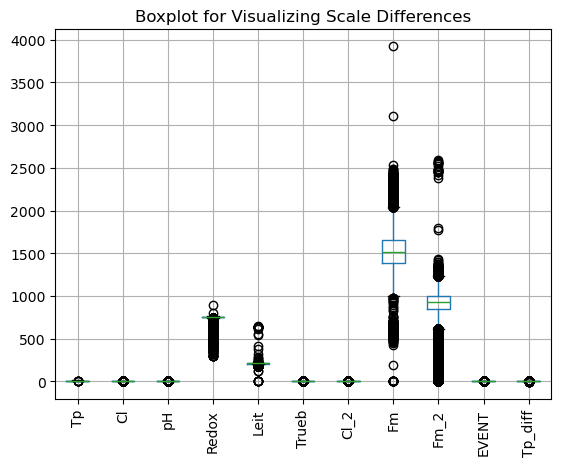

In [25]:
import matplotlib.pyplot as plt

def plot_boxplot(df_to_plot, title='Boxplot for Visualizing Scale Differences'):
    df_to_plot.boxplot(return_type='dict')
    plt.xticks(rotation=90)  # Rotate labels for better readability
    plt.title(title)
    plt.show()
    
plot_boxplot(df)

##### Interpretation of statistics and boxplots

Significant Differences: As we can see from the statistics and the boxplots, there are significant scale differences across the variables. For instance, `Redox` and `Leit` measurements are in the hundreds, whereas `pH` is a single-digit scale, and `Cl`, `Cl_2`, `Trueb` are in small decimal values.

Implications for Modeling: These scale differences could bias a model that assumes equal weighting or influence across features. Variables like `Leit` and `Fm` might unduly influence the model due to their larger scale.

Need for scaling: Before proceeding with VAR modeling, it would be prudent to standardize or normalize these variables to ensure no single variable disproportionately influences the model's outcome. This normalization also aids in more meaningful comparisons of coefficients across different variables in the model.

##### Scaling the Data

For scaling, we can use the MinMaxScaler or StandardScaler from scikit-learn. Standardization is generally more robust to outliers, as it focuses on centering the distribution of the data. Min-Max scaling, on the other hand, actually rescales the data and can therefore be more sensitive to outlier values. Since outliers are a concern in our dataset, Standardization might be a better choice.



In [28]:
from sklearn.preprocessing import StandardScaler

# Initialize the StandardScaler
scaler = StandardScaler()

# Select columns to scale, we might exclude non-numeric columns or columns that don't need scaling
columns_to_scale = ['Tp', 'Cl', 'pH', 'Redox', 'Leit', 'Trueb', 'Cl_2', 'Fm', 'Fm_2']

# Scale these columns
df_scaled = df.copy()
df_scaled[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])

In [29]:
# Check the scaled data
print(df_scaled.describe())

                 Tp            Cl            pH         Redox          Leit  \
count  1.385200e+05  1.385200e+05  1.385200e+05  1.385200e+05  1.385200e+05   
mean  -8.535541e-16 -2.074793e-15 -1.825293e-14  4.120040e-16 -9.192121e-16   
std    1.000004e+00  1.000004e+00  1.000004e+00  1.000004e+00  1.000004e+00   
min   -6.650591e+00 -1.621273e+01 -4.296607e+01 -3.498553e+01 -2.704364e+01   
25%   -7.971790e-01 -5.370808e-01 -2.599314e-01 -1.466978e-01 -6.724162e-02   
50%   -9.476961e-02  4.426475e-01  3.527232e-02  8.504608e-02  1.909057e-01   
75%    7.637308e-01  4.426475e-01  2.320748e-01  2.395420e-01  1.909057e-01   
max    2.558777e+00  6.216553e+01  5.607022e+00  1.097701e+01  5.633795e+01   

              Trueb          Cl_2            Fm          Fm_2        Tp_diff  
count  1.385200e+05  1.385200e+05  1.385200e+05  1.385200e+05  138520.000000  
mean  -7.583500e-16  2.101056e-16  2.232372e-16  4.103625e-17       0.000026  
std    1.000004e+00  1.000004e+00  1.000004e+00  1.

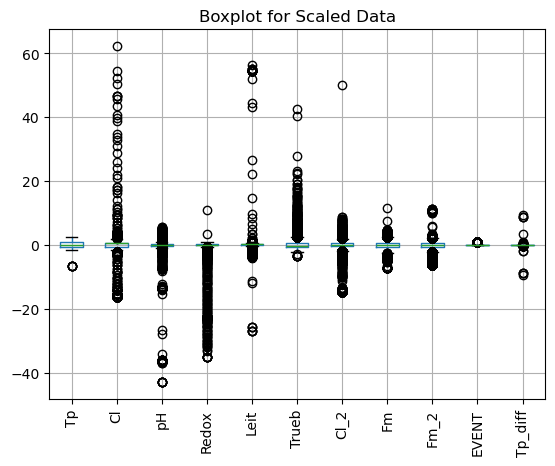

In [30]:
# Plot the boxplot for the scaled data
plot_boxplot(df_scaled, title='Boxplot for Scaled Data')

From the statistics and boxplots, we can interpret some key points:
- Mean:
    - The means are very close to zero for all variables, This is expected after standardization and indicates that the mean of each variable has been centered around zero.
    - Mean values near zero after standardization validate that the transformation was performed correctly.
- Standard Deviation:
    - The standard deviations are very close to 1. This also meets the expectation for Z-score normalization, where data is scaled to have a unit standard deviation.
    - A standard deviation of 1 for each variable ensures that all variables now share the same scale, eliminating the bias that might occur due to the original scales of the variables.
- Min and Max Values:
    - The min and max values now represent how many standard deviations the observations are from the mean. Extremely large or small values (in absolute terms) indicate outliers.
    - For example, the max value for `Leit` being approximately 56.34 means there are values in `Leit` that are more than 56 standard deviations away from the mean, highlighting significant outliers.
- Quartiles (25%, 50%, 75%):
    - The quartiles are also transformed. These should now better reflect the distribution symmetry around the mean (0). The 50th percentile (median) should be very close to zero, indicating the median is now centered.     

### Model Fitting

After preprocessing the data, we can now fit a VAR model to the multivariate time series. We will use the statsmodels library, which provides an implementation of VAR models.

Before fitting the VAR model, we must decide on the number of lags to use in the model. This decision can significantly affect the model's performance. We can use information like Akaike Information Criterion (AIC) or Bayesian Information Criterion (BIC) to determine the optimal number of lags. Lower values of these criteria generally indicate a better model, balancing between model complexity (more lags) and goodness of fit.

`statsmodels` provides tools to automatically select an optimal lag length based on the information criteria.

In [31]:
df_scaled.head()

,Time,Tp,Cl,pH,Redox,Leit,Trueb,Cl_2,Fm,Fm_2,EVENT,Tp_diff
1,2016-08-03 09:50:00+00:00,-1.577634,0.442648,-0.063129,-0.301194,0.190906,-1.598452,1.668833,0.128700,-1.571624,False,0.0
2,2016-08-03 09:51:00+00:00,-1.577634,0.442648,-0.161530,-0.301194,0.190906,-1.598452,1.528610,0.224775,-1.571624,False,0.0
3,2016-08-03 09:52:00+00:00,-1.577634,0.442648,-0.161530,-0.301194,0.190906,-1.598452,1.668833,0.215167,-1.591970,False,0.0
4,2016-08-03 09:53:00+00:00,-1.577634,0.442648,-0.161530,-0.301194,0.190906,-1.598452,1.668833,0.157523,-1.619099,False,0.0
5,2016-08-03 09:54:00+00:00,-1.577634,0.442648,-0.161530,-0.301194,0.190906,-1.416357,1.668833,0.090270,-1.619099,False,0.0


In [32]:
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller

# 
df_scaled.set_index('Time', inplace=True)  # Set the Time column as the index
df_scaled_numeric = df_scaled.drop(['EVENT'], axis=1)  # Drop non-numeric columns
print(df_scaled_numeric.dtypes) # Check the data types to ensure they are numeric

Tp         float64
Cl         float64
pH         float64
Redox      float64
Leit       float64
Trueb      float64
Cl_2       float64
Fm         float64
Fm_2       float64
Tp_diff    float64
dtype: object


               Tp        Cl        pH     Redox      Leit     Trueb      Cl_2  \
Tp       1.000000 -0.008100  0.192966  0.034940 -0.280992 -0.323874 -0.470641   
Cl      -0.008100  1.000000  0.175599  0.122284  0.025297  0.018689  0.164841   
pH       0.192966  0.175599  1.000000  0.650573 -0.154191 -0.067470  0.106813   
Redox    0.034940  0.122284  0.650573  1.000000 -0.179172  0.017341  0.459657   
Leit    -0.280992  0.025297 -0.154191 -0.179172  1.000000 -0.058990 -0.085530   
Trueb   -0.323874  0.018689 -0.067470  0.017341 -0.058990  1.000000  0.319056   
Cl_2    -0.470641  0.164841  0.106813  0.459657 -0.085530  0.319056  1.000000   
Fm      -0.388687  0.025855 -0.083951  0.034427 -0.005507  0.391007  0.405418   
Fm_2    -0.058387  0.016280 -0.044511  0.046339 -0.038558  0.197138  0.172158   
Tp_diff  0.030837  0.119666  0.133564  0.111174  0.087186  0.012310  0.047861   

               Fm      Fm_2   Tp_diff  
Tp      -0.388687 -0.058387  0.030837  
Cl       0.025855  0.016280 

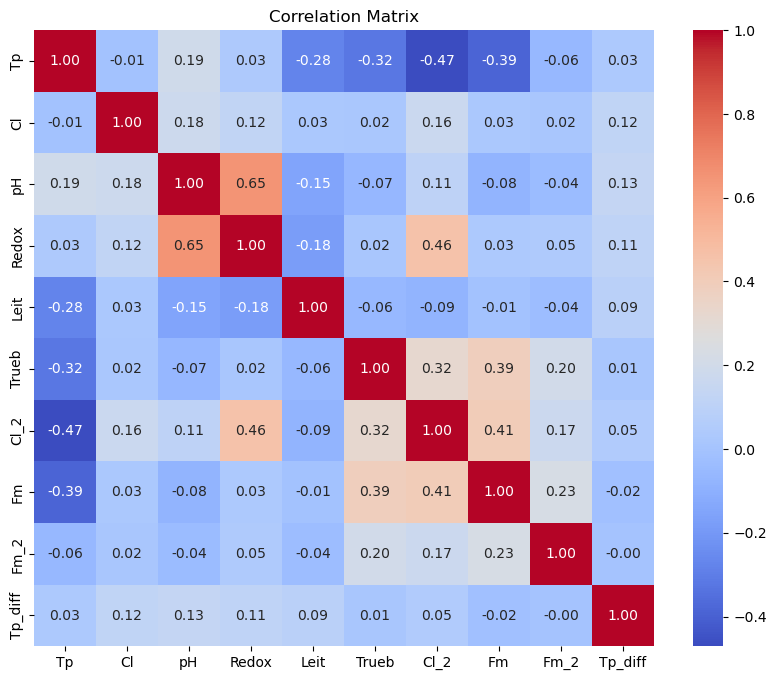

In [35]:

print(df_scaled_numeric.corr())

plt.figure(figsize=(10, 8))
sns.heatmap(df_scaled_numeric.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Matrix")
plt.show()

Before creating the VAR model, it's essential to check the correlation between the variables in case of multicollinearity. The correlation marix provides insights into the relationships between the variables. We can observe the following:

High Correlations:
- `pH` and `Redox`: 0.65
- `Trueb` and `Fm`: 0.39
- `Cl_2` and `Redox`: 0.46
- `Cl_2` and `Fm`: 0.41
- `Fm` and `Fm_2`: 0.23 

Interpretation:
- `pH` and `Redox` (0.65): This is a strong correlation and suggests that as the pH increases, the Redox potential also tends to increase. Given the nature of water chemistry, this relationship is expected.
- `Trueb` and `Fm` (0.39): While not extremely high, this correlation suggests a moderate relationship, possibly indicating that as flow rate (`Fm`) increases, turbidity (`Trueb`) also increases, which could be due to disturbances in water flow stirring up sediments.
- `Cl_2` and `Redox` (0.46); Cl_2 and Fm (0.41): These relationships might indicate shared variance due to external factors influencing both measurements.
- `Fm` and `Fm_2` (0.23): This shows some relationship but may not be strong enough to warrant removal unless reducing model complexity is critical.

Proposed Actions:
- Remove Highly Correlated Variables: First we can start by removing one of the highly correlated pairs. We might remove Redox if our analysis will not lose critical insights by its exclusion. This can help stabilize the VAR model.
- Combining Variables: In some cases, combining correlated variables into a single variable might make sense. For instance, if `Fm` and `Fm_2` represent similar processes, averaging them or creating a composite index could reduce multicollinearity while preserving information.


In [36]:
df_scaled_numeric = df_scaled_numeric.drop(['Redox'], axis=1)

In [41]:
df_scaled_numeric.head()

,Tp,Cl,pH,Leit,Trueb,Cl_2,Fm,Fm_2,Tp_diff
Time,,,,,,,,,
2016-08-03 09:50:00+00:00,-1.577634,0.442648,-0.063129,0.190906,-1.598452,1.668833,0.128700,-1.571624,0.0
2016-08-03 09:51:00+00:00,-1.577634,0.442648,-0.161530,0.190906,-1.598452,1.528610,0.224775,-1.571624,0.0
2016-08-03 09:52:00+00:00,-1.577634,0.442648,-0.161530,0.190906,-1.598452,1.668833,0.215167,-1.591970,0.0
2016-08-03 09:53:00+00:00,-1.577634,0.442648,-0.161530,0.190906,-1.598452,1.668833,0.157523,-1.619099,0.0
2016-08-03 09:54:00+00:00,-1.577634,0.442648,-0.161530,0.190906,-1.416357,1.668833,0.090270,-1.619099,0.0


#### Split the Data into Training and Testing Sets

In [49]:
# Define the split ratio
split_ratio = 0.9  # This means 80% for training and 20% for testing

# Calculate the split index
split_idx = int(len(df_scaled_numeric) * split_ratio)

print(split_idx)

# Split the data
train = df_scaled_numeric.iloc[:split_idx]
test = df_scaled_numeric.iloc[split_idx:]

# You can also use dates directly if you prefer specific cut-off points
# which update as new data comes in:
split_date = df_scaled_numeric.index[split_idx]

print(split_date)

train_scaled_numeric = df_scaled_numeric[:split_date]
test_scaled_numeric = df_scaled_numeric[split_date:]

print(f"Training set shape: {train.shape}")
print(f"Testing set shape: {test.shape}")

124668
2016-10-29 16:03:00+00:00
Training set shape: (124668, 9)
Testing set shape: (13852, 9)


In [50]:
# Assuming df_scaled is your scaled DataFrame and has a datetime index
model = VAR(train_scaled_numeric)
selected_lags = model.select_order(maxlags=3)
print(selected_lags.summary())
      
optimal_lag = selected_lags.aic
var_model = model.fit(optimal_lag)
print(var_model.summary())

/Users/tanle/miniconda3/envs/tsa/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



 VAR Order Selection (* highlights the minimums) 
      AIC         BIC         FPE         HQIC   
-------------------------------------------------
0      -7.909      -7.908   0.0003676      -7.908
1      -63.30      -63.30   3.216e-28      -63.30
2     -64.31*     -64.30*  1.174e-28*     -64.31*
3      -62.59      -62.57   6.565e-28      -62.58
-------------------------------------------------
  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 28, Jun, 2024
Time:                     00:58:14
--------------------------------------------------------------------
No. of Equations:         9.00000    BIC:                   -63.7962
Nobs:                     124667.    HQIC:                  -63.8056
Log likelihood:       2.38559e+06    FPE:                1.94019e-28
AIC:                     -63.8096    Det(Omega_mle):     1.93795e-28
--------------------------------------------------------------------
Results for

/Users/tanle/miniconda3/envs/tsa/lib/python3.11/site-packages/statsmodels/tsa/vector_ar/var_model.py:1558: RuntimeWarning:

invalid value encountered in sqrt



In [51]:
from statsmodels.stats.stattools import durbin_watson

# Check for autocorrelation of residuals using Durbin-Watson statistic
dw_results = durbin_watson(var_model.resid)

for eqn, stat in zip(df_scaled_numeric.columns, dw_results):
    print(f'{eqn}: Durbin-Watson stat={stat:.2f}')

Tp: Durbin-Watson stat=1.95
Cl: Durbin-Watson stat=2.05
pH: Durbin-Watson stat=2.01
Leit: Durbin-Watson stat=2.07
Trueb: Durbin-Watson stat=2.16
Cl_2: Durbin-Watson stat=2.08
Fm: Durbin-Watson stat=2.17
Fm_2: Durbin-Watson stat=2.06
Tp_diff: Durbin-Watson stat=1.95


### Forecasting

Use the fitted VAR model to forecast values for the period covered by your test set.

In [52]:
lag_order = var_model.k_ar  # The number of lags used in the model
forecasted_values = var_model.forecast(train_scaled_numeric.values[-lag_order:], steps=len(test_scaled_numeric))
forecasted_df = pd.DataFrame(forecasted_values, index=test_scaled_numeric.index, columns=test_scaled_numeric.columns)

In [55]:
forecasted_df.head()

,Tp,Cl,pH,Leit,Trueb,Cl_2,Fm,Fm_2,Tp_diff
Time,,,,,,,,,
2016-10-29 16:03:00+00:00,1.787550,0.450440,0.567756,-0.682450,-1.168244,-1.122136,-0.074122,0.191852,0.011823
2016-10-29 16:04:00+00:00,1.268909,8.651246,-4.273793,-2.584424,-30.732773,20.999000,-9.041323,-3.544933,-0.664537
2016-10-29 16:05:00+00:00,1.173285,-6.946098,-3.883160,-3.044886,-7.221186,-8.427961,-0.740163,-3.036305,-0.122524
2016-10-29 16:06:00+00:00,-1.773213,65.926377,-32.975795,-13.666465,-216.451242,168.599945,-65.961827,-28.497722,-3.775359
2016-10-29 16:07:00+00:00,-0.197623,-93.754107,-8.928506,-9.360630,90.588658,-161.495463,35.665873,-6.928690,2.018808


In [56]:
len(forecasted_df)

13852

### Comparing Forecasted Values to Actual Observations



In [62]:
test_scaled_numeric.head()
len(test_scaled_numeric)
test_scaled_numeric.shape

(13852, 9)

In [63]:
forecasted_df.head()
len(forecasted_df)
forecasted_df.shape

(13852, 9)

In [64]:
print(test_scaled_numeric.dtypes)
print(forecasted_df.dtypes)

Tp         float64
Cl         float64
pH         float64
Leit       float64
Trueb      float64
Cl_2       float64
Fm         float64
Fm_2       float64
Tp_diff    float64
dtype: object
Tp         float64
Cl         float64
pH         float64
Leit       float64
Trueb      float64
Cl_2       float64
Fm         float64
Fm_2       float64
Tp_diff    float64
dtype: object


In [71]:
print(test_scaled_numeric.describe())
print()
print(forecasted_df.describe())


                 Tp            Cl            pH          Leit         Trueb  \
count  13852.000000  13852.000000  13852.000000  13852.000000  13852.000000   
mean       1.690062     -0.077842      0.299468     -1.535571     -0.022310   
std        0.190775      0.624262      1.323806      2.340094      0.611398   
min        1.153958    -16.212735    -36.865191    -11.812945     -1.234261   
25%        1.622231     -0.537081      0.232075     -2.519641     -0.323783   
50%        1.700277     -0.537081      0.330476     -1.745199      0.040408   
75%        1.856368      0.442648      0.428877     -0.841684      0.222504   
max        2.012459      2.402104      1.708093     56.337948     18.249973   

               Cl_2            Fm          Fm_2       Tp_diff  
count  13852.000000  13852.000000  13852.000000  13852.000000  
mean      -0.500921     -0.525574     -0.178170     -0.000051  
std        0.960397      0.668418      0.761705      0.041023  
min      -14.877503     -2.50855

/Users/tanle/miniconda3/envs/tsa/lib/python3.11/site-packages/pandas/core/nanops.py:1016: RuntimeWarning:

overflow encountered in square

/Users/tanle/miniconda3/envs/tsa/lib/python3.11/site-packages/pandas/core/nanops.py:1016: RuntimeWarning:

overflow encountered in square

/Users/tanle/miniconda3/envs/tsa/lib/python3.11/site-packages/pandas/core/nanops.py:1016: RuntimeWarning:

overflow encountered in square

/Users/tanle/miniconda3/envs/tsa/lib/python3.11/site-packages/pandas/core/nanops.py:1016: RuntimeWarning:

overflow encountered in square

/Users/tanle/miniconda3/envs/tsa/lib/python3.11/site-packages/pandas/core/nanops.py:1016: RuntimeWarning:

overflow encountered in square

/Users/tanle/miniconda3/envs/tsa/lib/python3.11/site-packages/pandas/core/nanops.py:1016: RuntimeWarning:

overflow encountered in square

/Users/tanle/miniconda3/envs/tsa/lib/python3.11/site-packages/pandas/core/nanops.py:1016: RuntimeWarning:

overflow encountered in square

/Users/tanle/miniconda3/env

#### Addressing Extreme Values

Identifying Extreme and Infinite Values:

In [122]:
# Check for infinite values
print("Infinite values in test data:", test_scaled_numeric[~np.isfinite(test_scaled_numeric)].count())
print("Infinite values in forecast data:", forecasted_df[~np.isfinite(forecasted_df)].count())

# Replace infinities with NaN
test_scaled_numeric.replace([np.inf, -np.inf], np.nan, inplace=True)
forecasted_df.replace([np.inf, -np.inf], np.nan, inplace=True)

# Drop NaNs if necessary
test_scaled_numeric.dropna(inplace=True)
forecasted_df.dropna(inplace=True)


Infinite values in test data: Tp         0
Cl         0
pH         0
Leit       0
Trueb      0
Cl_2       0
Fm         0
Fm_2       0
Tp_diff    0
dtype: int64
Infinite values in forecast data: Tp         0
Cl         0
pH         0
Leit       0
Trueb      0
Cl_2       0
Fm         0
Fm_2       0
Tp_diff    0
dtype: int64


/var/folders/_h/b81zjqcs5xd2tm4s6hr8ng6r0000gn/T/ipykernel_21035/778695776.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_h/b81zjqcs5xd2tm4s6hr8ng6r0000gn/T/ipykernel_21035/778695776.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [123]:
# Cap values at the 99th percentile for each column in test and forecasted_df
for col in test_scaled_numeric.columns:
    upper_limit = test_scaled_numeric[col].quantile(0.99)
    lower_limit = test_scaled_numeric[col].quantile(0.01)
    test_scaled_numeric[col] = np.clip(test_scaled_numeric[col], lower_limit, upper_limit)
    forecasted_df[col] = np.clip(forecasted_df[col], lower_limit, upper_limit)


/var/folders/_h/b81zjqcs5xd2tm4s6hr8ng6r0000gn/T/ipykernel_21035/2321543695.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_h/b81zjqcs5xd2tm4s6hr8ng6r0000gn/T/ipykernel_21035/2321543695.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_h/b81zjqcs5xd2tm4s6hr8ng6r0000gn/T/ipykernel_21035/2321543695.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

In [124]:
# Recalculate errors
errors = test_scaled_numeric - forecasted_df
errors_mean = errors.mean()
errors_std = errors.std()

# Set new thresholds and detect anomalies
threshold = errors_mean + 1 * errors_std    # set how far the standard deviations from mean (1, 2, 3, ...)
upper_limit = threshold + errors_mean
lower_limit = -threshold + errors_mean


anomalies = (abs(errors) > threshold)
# print("Detected anomalies:\n", anomalies[anomalies.any(axis=1)].index)

# Get back the EVENT column for anomaly labels
event_data = df_scaled.loc[test_scaled_numeric.index, 'EVENT']
predicted_anomalies = anomalies.any(axis=1)  # This reduces it to a Series if anomalies were checked per column

# Align predicted anomalies with the event_data on the index
comparison_df = pd.DataFrame({
    'Predicted': predicted_anomalies,
    'Actual': event_data
})

Accuracy: 0.9488882471845221
Precision: 0.0
Recall: 0.0
F1 Score: 0.0
Confusion Matrix:
 [[13144   631]
 [   77     0]]


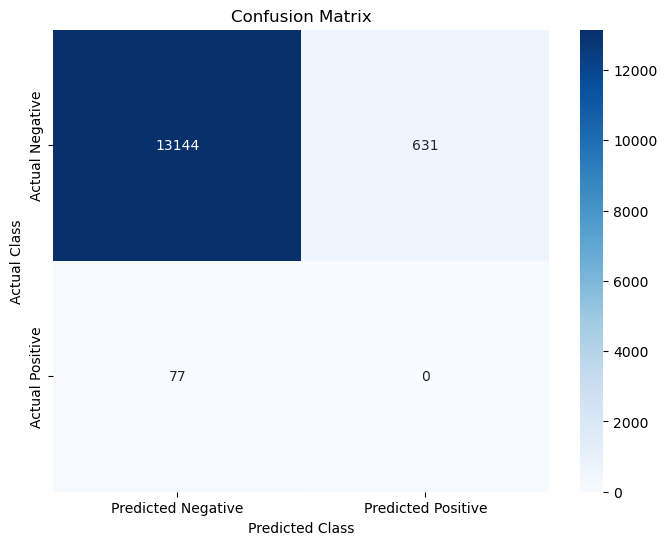

In [125]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

accuracy = accuracy_score(comparison_df['Actual'], comparison_df['Predicted'])
precision = precision_score(comparison_df['Actual'], comparison_df['Predicted'], zero_division=0)
recall = recall_score(comparison_df['Actual'], comparison_df['Predicted'])
f1 = f1_score(comparison_df['Actual'], comparison_df['Predicted'])

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

# Optional: Confusion Matrix
conf_matrix = confusion_matrix(comparison_df['Actual'], comparison_df['Predicted'])
print("Confusion Matrix:\n", conf_matrix)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", 
            xticklabels=['Predicted Negative', 'Predicted Positive'],
            yticklabels=['Actual Negative', 'Actual Positive'])
plt.title('Confusion Matrix')
plt.ylabel('Actual Class')
plt.xlabel('Predicted Class')
plt.show()


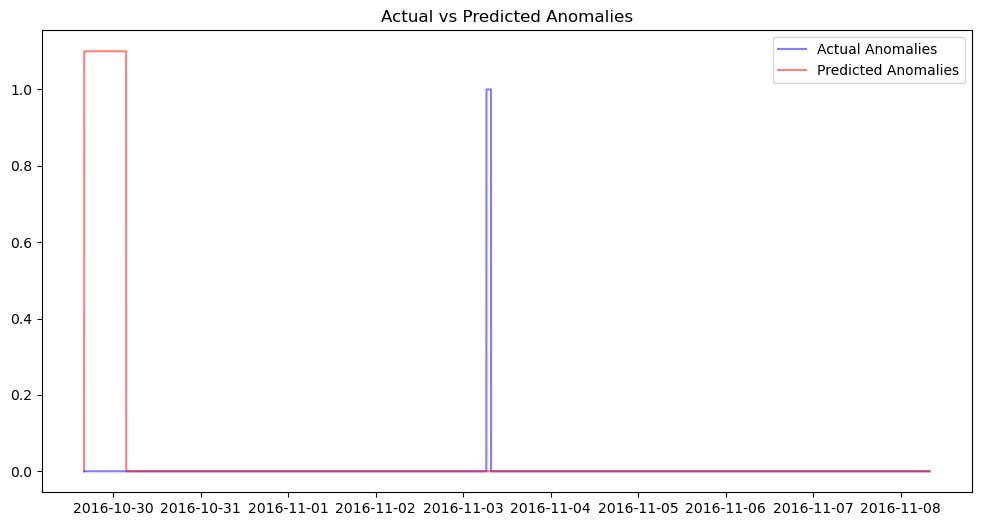

In [126]:
import matplotlib.pyplot as plt

# Plot actual vs predicted anomalies
plt.figure(figsize=(12, 6))
plt.plot(comparison_df.index, comparison_df['Actual'], label='Actual Anomalies', color='blue', alpha=0.5)
plt.plot(comparison_df.index, comparison_df['Predicted'] * 1.1, label='Predicted Anomalies', color='red', alpha=0.5)  # Multiply by 1.1 just for visual offset
plt.title('Actual vs Predicted Anomalies')
plt.legend()
plt.show()


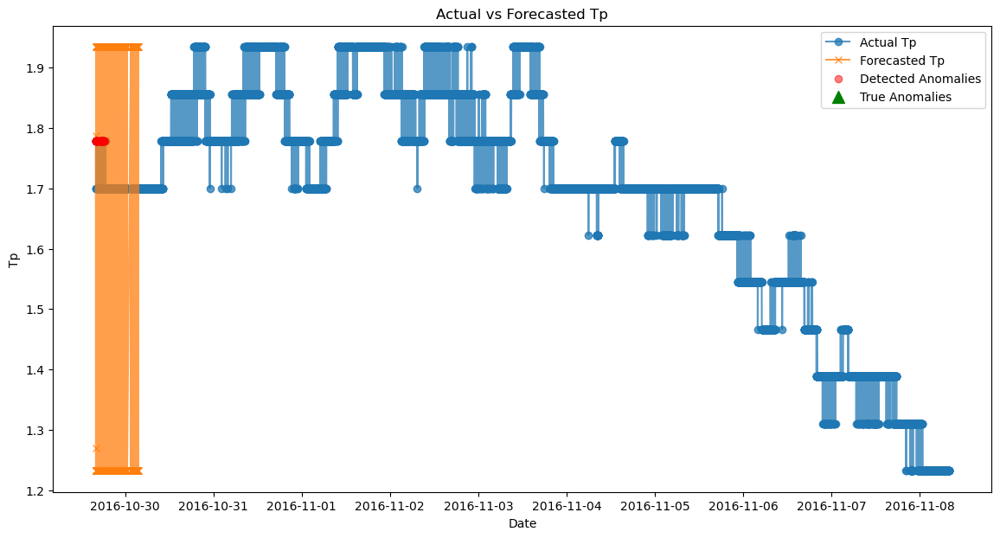

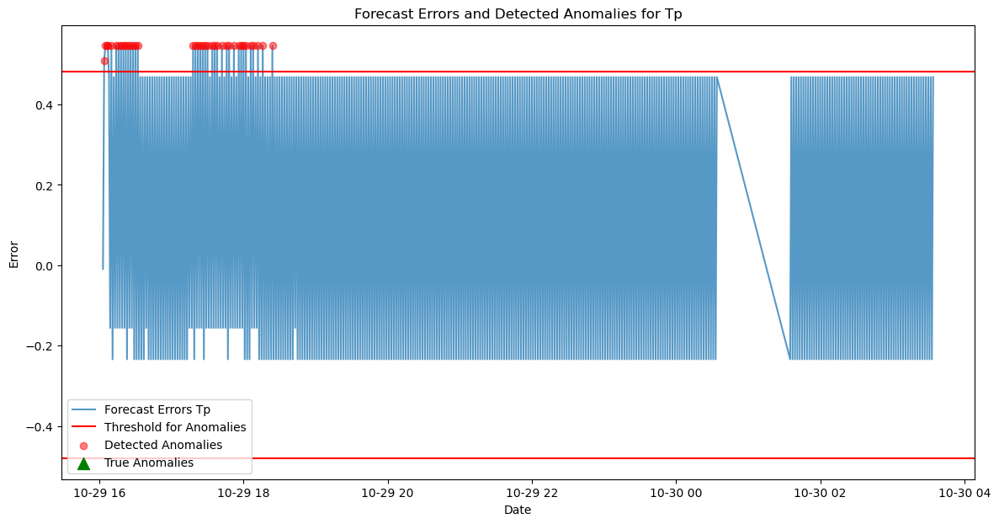

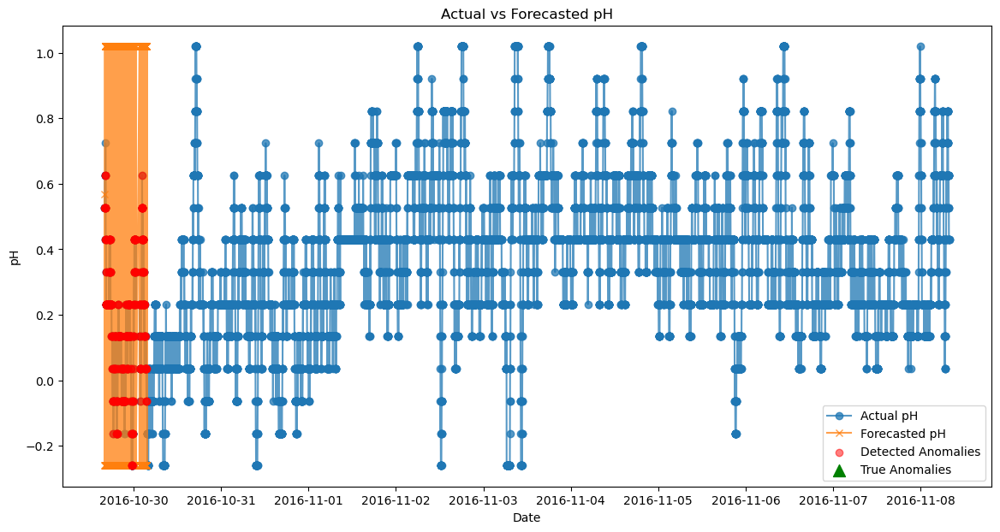

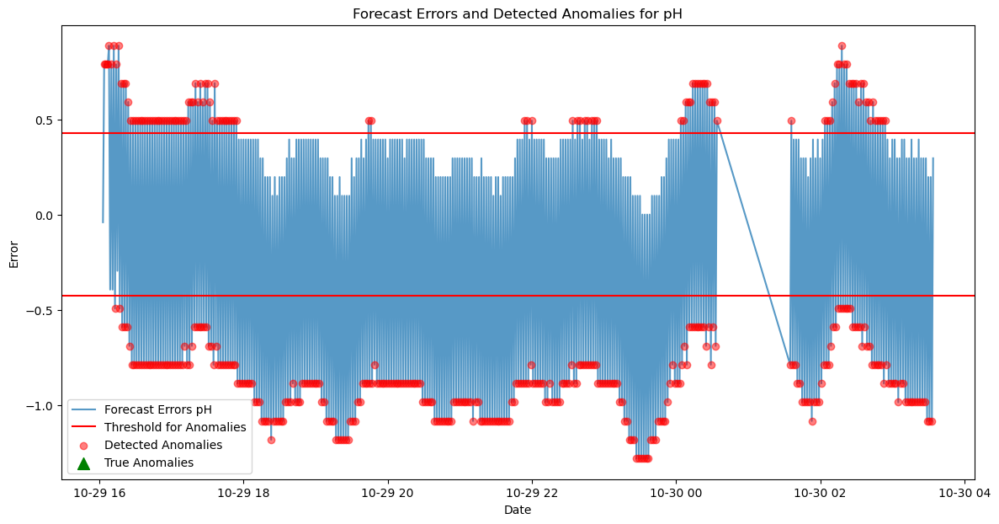

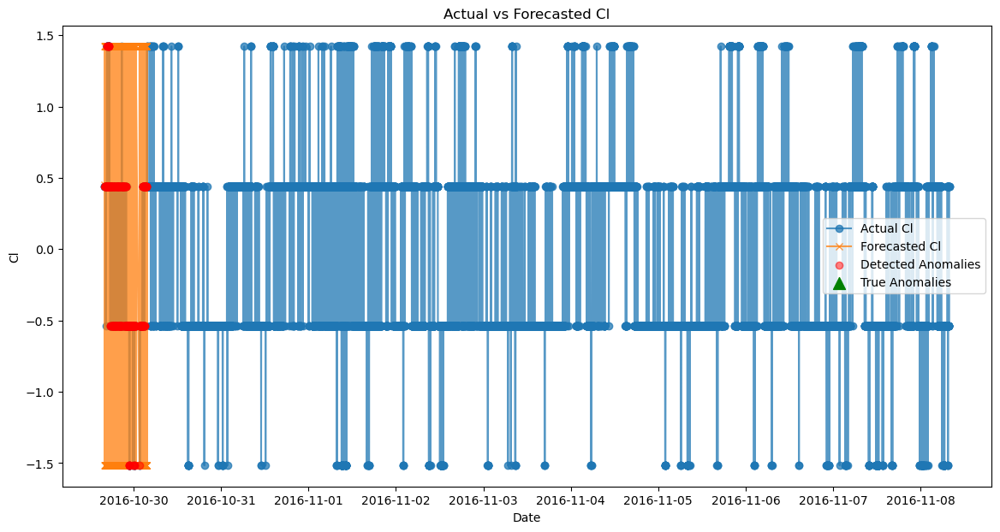

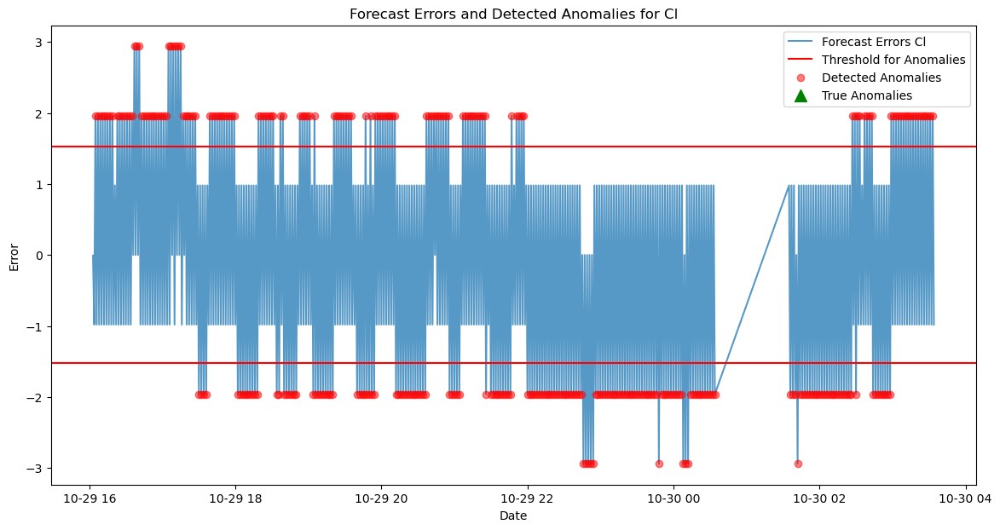

In [127]:
# List of variables to plot
variables_to_plot = ['Tp', 'pH', 'Cl']

for var in variables_to_plot:
    # Plotting forecast vs actuals
    plt.figure(figsize=(14, 7))
    plt.plot(test_scaled_numeric.index, test_scaled_numeric[var], label=f'Actual {var}', marker='o', alpha=0.75)  # Semi-transparent main line
    plt.plot(forecasted_df.index, forecasted_df[var], label=f'Forecasted {var}', marker='x', alpha=0.75)  # Semi-transparent forecast line
    plt.scatter(errors.index[anomalies[var]], test_scaled_numeric[var][anomalies[var]], color='red', label='Detected Anomalies', zorder=5, alpha=0.5)  # Red points with transparency
    plt.scatter(errors.index[event_data & anomalies[var]], test_scaled_numeric[var][event_data & anomalies[var]], color='green', marker='^', s=100, label='True Anomalies', zorder=5)  # Green points with distinctive markers

    # Optionally add annotations for clarity
    for idx in errors.index[event_data & anomalies[var]]:
        plt.annotate('Anomaly', (idx, test_scaled_numeric.loc[idx, var]), textcoords="offset points", xytext=(0,10), ha='center')

    plt.title(f'Actual vs Forecasted {var}')
    plt.xlabel('Date')
    plt.ylabel(var)
    plt.legend()
    plt.show()

    # Plotting errors with thresholds and anomalies
    plt.figure(figsize=(14, 7))
    plt.plot(errors.index, errors[var], label=f'Forecast Errors {var}', alpha=0.75)  # Error line semi-transparent
    plt.axhline(y=threshold[var], color='r', linestyle='-', label='Threshold for Anomalies')
    plt.axhline(y=-threshold[var], color='r', linestyle='-')
    plt.scatter(errors.index[anomalies[var]], errors[var][anomalies[var]], color='red', label='Detected Anomalies', zorder=5, alpha=0.5)  # Red points with transparency
    plt.scatter(errors.index[event_data & anomalies[var]], errors[var][event_data & anomalies[var]], color='green', marker='^', s=100, label='True Anomalies', zorder=5)  # Green points with distinctive markers

    plt.title(f'Forecast Errors and Detected Anomalies for {var}')
    plt.xlabel('Date')
    plt.ylabel('Error')
    plt.legend()
    plt.show()

In [128]:
print("Number of labeled anomalies in the test set:", event_data.sum())


Number of labeled anomalies in the test set: 77


### Analysis and Interpretation

#### Understanding the Metrics:

**Accuracy (94.89%)**: This is relatively high, but it is likely misleading in this context. High accuracy in this case is mostly due to the correct identification of true negatives, which are the normal cases where no anomaly is present. This is a common scenario in datasets where anomalies are rare compared to normal cases (a problem known as class imbalance).

**Precision (0.0%)**: This indicates that of all the instances where the model predicted an anomaly, none were actually true anomalies. This metric is crucial because it tells you how trustworthy the model's predictions are when it does predict an anomaly.

**Recall (0.0%)**: This measures the model's ability to identify actual anomalies. A recall of 0.0% means that the model failed to identify any of the true anomalies. This is a critical weakness in an anomaly detection system.

**F1 Score (0.0%)**: Given as the harmonic mean of precision and recall, this score is also 0.0% due to the zero values for both precision and recall. It indicates poor performance in terms of balancing precision and recall, essentially confirming that the model is not effective at detecting anomalies.

#### Interpretation and Next Steps:

**Model Sensitivity**: The model has not successfully identified any true anomalies, which is a significant issue for an anomaly detection system. The high number of false negatives suggests that the model's threshold for detecting anomalies may be set too high, or that the features and their transformations are not capturing the patterns that distinguish normal from anomalous behavior effectively.

#### Options for Adjusting the Model:
In the future, we think the model could be improved by:

**Revisit Feature Engineering**: Look at whether other features or transformations might better capture the anomalies.

**Adjust the Threshold**: Adjusting this threshold. Analyzing the distribution of the error terms or the residuals might help in setting a more effective threshold.

**Balancing the Data**: If the dataset is heavily imbalanced, consider techniques such as oversampling the minority class (anomalies) or under-sampling the majority class (normal instances) during training, or apply anomaly-specific cost functions.

**Evaluate Model's Assumptions**: Since the VAR model is primarily for forecasting, ensure its assumptions hold true for anomaly detection. Consider whether different models or a combination of models might be necessary to effectively identify anomalies.

#### Alternative Approaches:

**Machine Learning Models**: Consider using other machine learning approaches tailored for anomaly detection, such as `Isolation Forest`, `Cluster Analysis`, or `Neural Networks`, which might be more effective depending on the nature of the data.

**Hybrid Models**: Combining models might also be beneficial. For instance, using a VAR model for forecasting and a classification model for anomaly detection could leverage the strengths of both approaches.

### References

1. [Vector Autoregression (VAR) – Comprehensive Guide with Examples in Python](https://www.machinelearningplus.com/time-series/vector-autoregression-examples-python/)
2. [VAR Wikipedia](https://en.wikipedia.org/wiki/Vector_autoregression)
3. [Vector autoregression models by Kevin Kotzé](https://kevinkotze.github.io/ts-7-var/)